In [1]:
import tomotopy as tp

num_topics = 200
model = tp.CTModel.load(f'./cache/models/k{num_topics}_1_iter100.bin')

In [2]:
import numpy as np

weights = np.zeros(shape=(num_topics, len(model.get_topic_words(0, top_n=-1))), dtype=np.float32)
for i in range(num_topics):
    weights[i] = [v for n, v in model.get_topic_words(i, top_n=-1)]

weights[0]

array([2.6654404e-02, 2.1775296e-02, 1.8668128e-02, ..., 2.5098284e-08,
       2.5098284e-08, 2.5098284e-08], dtype=float32)

In [3]:
import pandas as pd

df = pd.DataFrame(weights, columns=[n for n, v in model.get_topic_words(i, top_n=-1)])
df.head()

,o_ADP,o_PPI,o_Pi,o_AMP,i_NADPH,i_S-ADENOSYLMETHIONINE,i_NAD,i_Pi,o_CO-A,o_CARBON-DIOXIDE,...,i_COUMARATE,i_BENZOYLCOA,i_CPD-10484,i_CPD-11984,i_Cyclic-3-5-Nucleoside-Monophosphates,i_CPD-15663,o_CPD-184,c_CPD0-1938,c_ILE,o_CPD-15567
0,0.026654,0.021775,0.018668,0.017995,0.017945,0.012223,0.011749,0.010644,0.010218,0.008651,...,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08
1,0.027364,0.027331,0.026396,0.017570,0.012288,0.010429,0.009160,0.009097,0.008859,0.008718,...,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08
2,0.032807,0.025684,0.023183,0.020903,0.014525,0.010955,0.010435,0.009738,0.008659,0.008616,...,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08
3,0.024183,0.016729,0.016429,0.014079,0.011736,0.011146,0.011123,0.010646,0.010608,0.009911,...,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08
4,0.023182,0.021365,0.021168,0.019607,0.017133,0.015250,0.013128,0.011707,0.010764,0.010240,...,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08


In [4]:
from local.caching import load, save

xdf: pd.DataFrame = load('biocyc_metabolite_usage', alt_workspace="../prep/")
xdf.head()

recovering & decompressing cached data from [../prep/cache/biocyc_metabolite_usage.pkl.gz]


,i_L-CYSTATHIONINE,i_UTP,i_CPD-12575,i_PPI,i_GLC-1-P,i_PROTON,i_ACP,i_MALONYL-COA,i_Hydroxymethylbilane-Synthase-ES2,i_PORPHOBILINOGEN,...,c_CPLX66-208,c_CPLX66-201,c_ENSG00000157933-MONOMER,c_O-Acyl-L-Carnitines,c_I-SMAD,c_UDP-GLUCURONATE,c_CPD-12575,c_NOREPINEPHRINE,c_Nucleoside-Monophosphates,c_3-4-DIHYDROXYBENZOATE
gcf_014653195cyc.pgdb,3,8,3,12,4,333,5,5,1,5,...,0,0,0,0,0,0,0,0,0,0
gcf_000359505cyc.pgdb,1,8,5,11,6,422,3,6,1,5,...,0,0,0,0,0,0,0,0,0,0
gcf_003952285cyc.pgdb,1,8,5,13,4,515,40,13,0,1,...,0,0,0,0,0,0,0,0,0,0
gcf_000744815cyc.pgdb,4,5,13,14,6,342,2,1,0,1,...,0,0,0,0,0,0,0,0,0,0
gcf_000701505cyc.pgdb,1,5,4,9,7,278,4,7,0,1,...,0,0,0,0,0,0,0,0,0,0


In [5]:
TOP_CUTT = 50

freq = sorted([(i, v) for i, v in enumerate(xdf.mean(axis=0))], key=lambda t: t[1], reverse=True)
column_filter = np.array(xdf.columns)[[i for i, v in freq[TOP_CUTT:]]]
column_filter = [c for c in column_filter if c in df.columns]

In [6]:
wv = weights.var(axis=0)
swv = sorted([(i, v) for i, v in enumerate(wv)], key=lambda t: t[1], reverse=True)
print(swv[:3])
cdf = df.iloc[:, [i for i, v in swv]][column_filter]
cdf.head()

[(0, 2.1619908e-05), (1, 1.3917697e-05), (2, 1.1579e-05)]


,o_Acceptor,i_Donor-H2,i_PPI,i_GLUTATHIONE,i_L-ASPARTATE,i_Red-Thioredoxin,o_Ox-Thioredoxin,o_CH33ADO,o_SUC,i_HCO3,...,o_epoxides,i_LIPOYL-ACP,i_CPD-8592,i_GalNAc-chondroitin-dermatan,o_LIPOYL-ACP,o_SUCB-LIPOATE,o_CPD-8592,o_GalNAc-chondroitin-dermatan,o_L-KYNURENINE,o_CPD1G-1530
0,0.002053,0.003095,0.000813,0.000532,0.001052,0.001247,0.003835,0.000720,0.002394,0.001084,...,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08,2.509828e-08
1,0.002240,0.002963,0.000823,0.000517,0.001054,0.001264,0.004315,0.000703,0.002552,0.001114,...,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08,2.508853e-08
2,0.002129,0.003090,0.000829,0.000490,0.001084,0.001272,0.004482,0.000680,0.002508,0.001127,...,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08,2.498216e-08
3,0.002006,0.002650,0.000844,0.000560,0.001029,0.001204,0.004062,0.000710,0.002229,0.001060,...,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08,2.535403e-08
4,0.001942,0.002571,0.000805,0.000524,0.000984,0.001130,0.004360,0.000710,0.002252,0.001010,...,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08,2.555645e-08


In [11]:
# lower = np.quantile(df, q=0.25, axis=0)
# upper = np.quantile(df, q=0.75, axis=0)
lower = df.min(axis=0)
upper = df.max(axis=0)
rrange = upper-lower
sdf = (df-lower)/rrange

In [8]:
df.to_numpy().shape

(200, 14559)

/home/tony/Utilities/mambaforge/envs/tomatopy/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


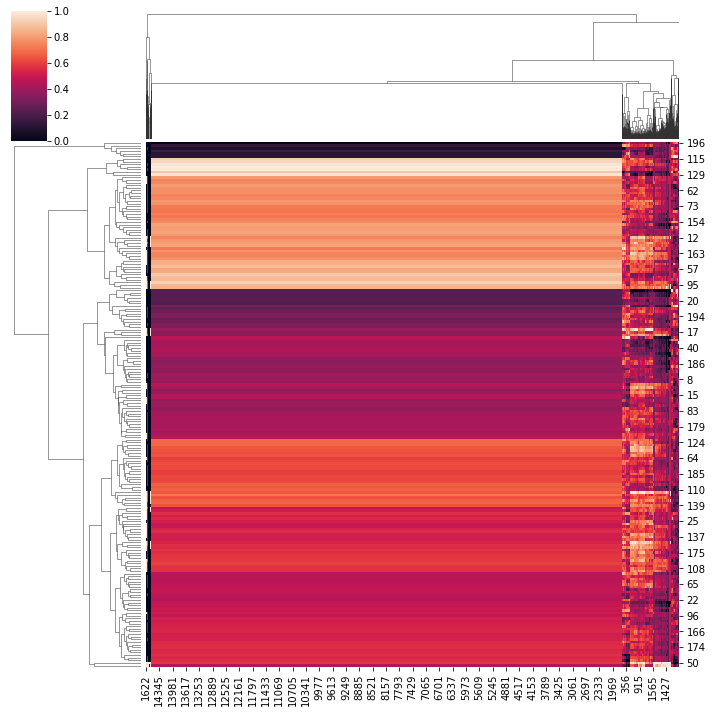

In [12]:
import seaborn as sns
import sys
sys.setrecursionlimit(100000)

sns.clustermap(sdf.to_numpy())

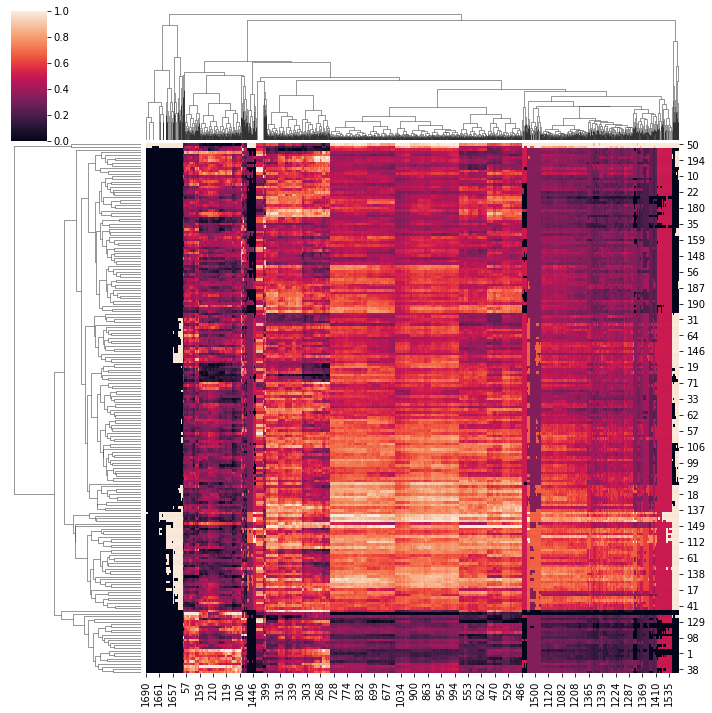

In [13]:
feature_cutt = 1750

sns.clustermap(sdf.to_numpy()[:, :feature_cutt])

In [8]:
import plotly.graph_objects as go
# feature_cutt = 1750

mat = sdf.to_numpy()[:, :feature_cutt]
fig = go.Figure(data=go.Heatmap(z=mat))
fig.show()

In [9]:
import os
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.manifold import TSNE

sorted_indicies_save = "sorted_indicies"
try:
    sorted_xs = load(f"{sorted_indicies_save}_x")
    sorted_ys = load(f"{sorted_indicies_save}_y")
except:
    def dist_sort(mat):
        cosdis = pairwise_distances(mat, metric="cosine", n_jobs=14)
        model = TSNE(n_components=1, learning_rate='auto', init="random", perplexity=100, metric="precomputed", n_jobs=12)
        positions = model.fit_transform(cosdis)
        clust_i = [i for i, _ in sorted([(i, p[0]) for i, p in enumerate(positions)], key=lambda t: t[1], reverse=True)]
        return clust_i

    sorted_xs = dist_sort(mat)
    sorted_ys = dist_sort(mat.T)
    save(f"{sorted_indicies_save}_x", sorted_xs)
    save(f"{sorted_indicies_save}_y", sorted_ys)

recovering & decompressing cached data from [{WORKSPACE}/main/rt01/cache/sorted_indicies_x.pkl.gz]
recovering & decompressing cached data from [{WORKSPACE}/main/rt01/cache/sorted_indicies_y.pkl.gz]


In [10]:
fig = go.Figure(data=go.Heatmap(z=sdf.iloc[sorted_xs, sorted_ys]))
fig.show()

In [11]:
# settings

axis_col = 'rgba(0, 0, 0, 0.15)'
no_col = 'rgba(0, 0, 0, 0)'
axis_desc: dict = dict(linecolor=no_col, gridcolor=axis_col, zerolinecolor=axis_col, zerolinewidth=1)
layout = dict(
    autosize=False,
    width=1400,
    height=650,
    margin=dict(
        l=25, r=25, b=25, t=50, pad=5
    ),
    # paper_bgcolor="white",
    font_family="Times New Roman",
    font_color="black",
    font_size=20,
    plot_bgcolor='white',
    xaxis=axis_desc,
    yaxis=axis_desc,
    xaxis2=axis_desc,
    yaxis2=axis_desc,
)

def compare_prevalence():
    mat = xdf[df.columns].to_numpy()
    prevalence_orig = mat.sum(axis=0)/mat.sum(axis=0).max()

    mat = df.to_numpy()
    prevalence_topics =mat.sum(axis=0)/mat.sum(axis=0).max()

    sort_i = sorted([(i, v) for i, v in enumerate(prevalence_orig)], key=lambda t: t[1], reverse=True)
    sort_i = [i for i, v in sort_i]
    prevalence_orig = prevalence_orig[sort_i]
    prevalence_topics = prevalence_topics[sort_i]

    s, o = 5, 0.3
    fig = go.Figure(data=[
        go.Scatter(
            x=[i for i, v in enumerate(prevalence_topics)],
            y=[v for i, v in enumerate(prevalence_topics)],
            mode='markers',
            marker=dict(size=s,opacity=o)
        ),
        go.Scatter(
            x=[i for i, v in enumerate(prevalence_orig)],
            y=[v for i, v in enumerate(prevalence_orig)],
            mode='markers',
            marker=dict(size=s,opacity=o) 
        ),
    ])
    _layout = layout.copy()
    _layout.update(dict(
        xaxis=dict(title="", **axis_desc),
        yaxis=dict(title="", **axis_desc),
    ))
    fig.update_annotations(font_size=24)
    fig.update_layout(_layout)
    fig.show()
compare_prevalence()

In [12]:
from tomotopy.utils import Corpus
all_corpus = Corpus.load('./cache/mock_all_corpus')

In [13]:
topic_d = []
for doc in model.docs:
    x = model.infer(doc)
    topic_d.append(x)

topic_d

[(array([0.00633667, 0.00493242, 0.0065122 , 0.00616114, 0.00440583,
         0.00300158, 0.0065122 , 0.00458136, 0.00352817, 0.00405477,
         0.00405477, 0.0037037 , 0.00545901, 0.00405477, 0.00545901,
         0.00335264, 0.00633667, 0.00598561, 0.00545901, 0.00668773,
         0.00545901, 0.00352817, 0.00282605, 0.00528348, 0.0042303 ,
         0.00545901, 0.00493242, 0.00616114, 0.00738985, 0.00387923,
         0.00545901, 0.0065122 , 0.00528348, 0.00475689, 0.00721432,
         0.00668773, 0.00493242, 0.00545901, 0.00510795, 0.00756539,
         0.00598561, 0.00458136, 0.0037037 , 0.0042303 , 0.0065122 ,
         0.0042303 , 0.00528348, 0.00493242, 0.00387923, 0.00703879,
         0.00581008, 0.00458136, 0.00493242, 0.00598561, 0.00493242,
         0.0042303 , 0.00458136, 0.00510795, 0.00510795, 0.00510795,
         0.00475689, 0.00405477, 0.00317711, 0.00440583, 0.00545901,
         0.00528348, 0.00510795, 0.00352817, 0.00475689, 0.00616114,
         0.00703879, 0.00598561, 0

In [22]:
s, o = 5, 1

sample = x[0]
sample = sorted(sample)
fig = go.Figure(data=[
    go.Scatter(
        x=[i for i, v in enumerate(sample)],
        y=[v for i, v in enumerate(sample)],
        mode='markers',
        marker=dict(size=s,opacity=o)
    ),
])
_layout = layout.copy()
_layout.update(dict(
    xaxis=dict(title="topic", **axis_desc),
    yaxis=dict(title="fraction", **axis_desc),
    width=900
))
fig.update_annotations(font_size=24)
fig.update_layout(_layout)
fig.show()